<a href="https://colab.research.google.com/github/maria-igntv/Logit-Lens-in-LMMs-Research-Work/blob/main/LogitLens_for_Qwen2_VL_T_bank_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<a href="https://colab.research.google.com/drive/1Y_Ct244v-EDN1I4i49FWY4KvnmpSHJ26?usp=sharing" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Logit Lens, как метод анализа внутренней работы нейросетей.**

Трансформерные модели делают вероятностные предсказания в пространстве словаря, вычисляя линейную функцию от активаций на своём последнем слое. Если мы последовательно применим ту же функцию к *активациям каждого из промежуточных слоёв*, мы получим так называемую "эволюцию" предсказаний — список токенов, который интуитивно показывает, во что модель верит после каждого шага обработки.

Более формально, для трансформерной модели с $L$ слоями, распределение предсказаний на слое $l$ можно выразить как :

\begin{equation}
p_{l}(x_{t+1}|x_{\leq t})=\text{softmax}(W_{\text{head}}\cdot\text{Norm}(h_{l}^{(t)}))
\end{equation}
где $h_{l}^{(t)} -$  скрытое состояние на слое $l$ для позиции $t$, Norm представляет нормализацию конечного слоя модели, а $W_{\text{head}} - $  матрицу весов головы LLM. [[1]( https://doi.org/10.48550/arXiv.2503.11667)]

Этот процесс называется **Logit Lens** и представляет собой интересный способ "заглянуть под капот" процесса обучения трансформерных моделей.


Такой подход даёт понять, на каком этапе происходят ключевые вычисления, упрощает анализ трансформеров и помогает лучше разбираться в том, как внутри них устроена обработка информации.


Исследуем, как "думает" мультимодальная модель `Qwen2-VL` на разных уровнях обработки с применением подхода **Logit Lens**.


#0. Setup

In [1]:
%%capture

!pip install git+https://github.com/huggingface/transformers@21fac7abba2a37fae86106f87fcf9974fd1e3830 accelerate
!pip install qwen-vl-utils
!pip install torchinfo
!pip install matplotlib torch transformers
!pip install tqdm
!pip install transformers

In [165]:
import torch
import torch.nn.functional as F
from torchinfo import summary

import transformers
from transformers import Qwen2VLForConditionalGeneration, AutoTokenizer, AutoProcessor
from transformers import AutoTokenizer
from qwen_vl_utils import process_vision_info

import importlib
import logit_lens_analysis
from logit_lens_analysis import run_logit_lens_analysis


import matplotlib
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from matplotlib.patches import Rectangle
import warnings

from tqdm.notebook import tqdm
from PIL import Image
import requests
from io import BytesIO
import gc
import warnings
import ast

In [3]:
USE_GPU = torch.cuda.is_available()

device = torch.device("cuda" if USE_GPU else "cpu")
device

device(type='cuda')

# 1. Загрузка Qwen2-VL

In [4]:
model = Qwen2VLForConditionalGeneration.from_pretrained(
    "Qwen/Qwen2-VL-2B-Instruct",
    torch_dtype=torch.bfloat16,
    device_map="auto",
).to(device)

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json: 0.00B [00:00, ?B/s]

model.safetensors.index.json: 0.00B [00:00, ?B/s]

model-00001-of-00002.safetensors:   0%|          | 0.00/3.99G [00:00<?, ?B/s]

model-00002-of-00002.safetensors:   0%|          | 0.00/429M [00:00<?, ?B/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/272 [00:00<?, ?B/s]

In [5]:
min_pixels = 256*28*28
'''
  Каждое изображение будет закодировано 256 токенами.
  Число 28 получается из пространствеенного размера патча (14) и временного размера патча (2).
'''
max_pixels = 256*28*28
processor = AutoProcessor.from_pretrained("Qwen/Qwen2-VL-2B-Instruct", min_pixels=min_pixels, max_pixels=max_pixels)

preprocessor_config.json:   0%|          | 0.00/347 [00:00<?, ?B/s]

tokenizer_config.json: 0.00B [00:00, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

chat_template.json: 0.00B [00:00, ?B/s]

In [6]:
messages = [
    {
        "role": "user",
        "content": [
            {
                "type": "image",
                "image": "https://qianwen-res.oss-cn-beijing.aliyuncs.com/Qwen-VL/assets/demo.jpeg",
            },
            {"type": "text", "text": "Describe this image."},
        ],
    }
]


In [7]:
image_url = messages[0]["content"][0]["image"]
text_prompt = messages[0]["content"][1]["text"]

In [8]:
image = Image.open(BytesIO(requests.get(image_url).content)).convert("RGB")

Qwen2-VL model prompt: Describe this image.


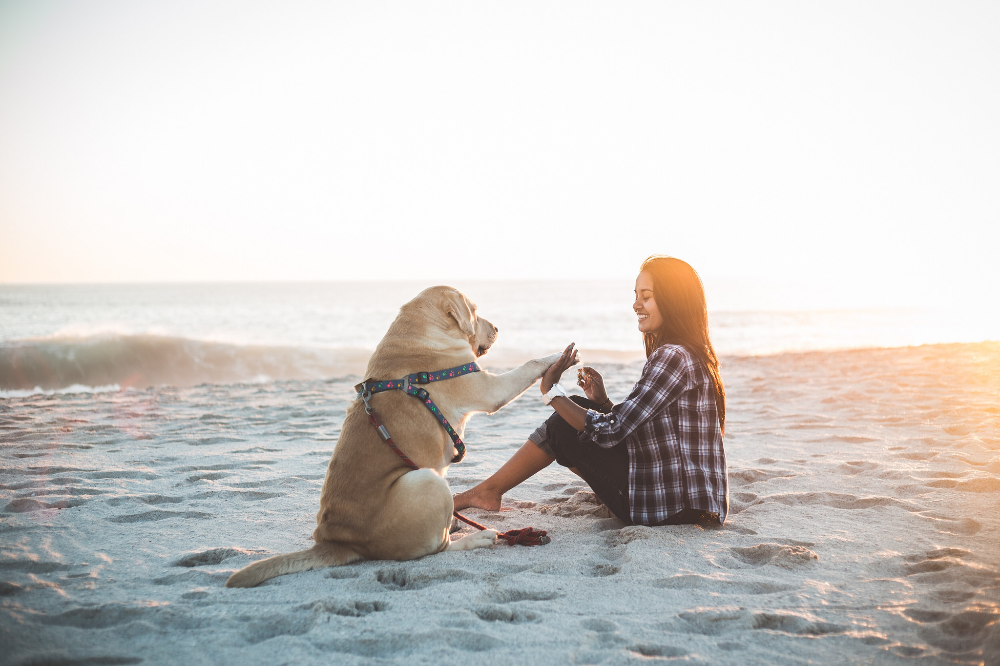

In [9]:
print("Qwen2-VL model prompt:", text_prompt)

image

In [10]:
print(model)

Qwen2VLForConditionalGeneration(
  (visual): Qwen2VisionTransformerPretrainedModel(
    (patch_embed): PatchEmbed(
      (proj): Conv3d(3, 1280, kernel_size=(2, 14, 14), stride=(2, 14, 14), bias=False)
    )
    (rotary_pos_emb): VisionRotaryEmbedding()
    (blocks): ModuleList(
      (0-31): 32 x Qwen2VLVisionBlock(
        (norm1): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
        (norm2): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
        (attn): VisionSdpaAttention(
          (qkv): Linear(in_features=1280, out_features=3840, bias=True)
          (proj): Linear(in_features=1280, out_features=1280, bias=True)
        )
        (mlp): VisionMlp(
          (fc1): Linear(in_features=1280, out_features=5120, bias=True)
          (act): QuickGELUActivation()
          (fc2): Linear(in_features=5120, out_features=1280, bias=True)
        )
      )
    )
    (merger): PatchMerger(
      (ln_q): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
      (mlp): Seq

**`model.lm_head`**  Linear(1536 → 151936). Это голова логитов, применяется к последнему hidden_state для получения логитов — используется в LogitLens.

**`model.model.norm`** Последний LayerNorm модели нужен для корректной нормализации перед `lm_head`.

In [11]:
print(model.lm_head)
print(model.model.norm)

Linear(in_features=1536, out_features=151936, bias=False)
Qwen2RMSNorm((1536,), eps=1e-06)


In [12]:
# Создание текстовой подсказки с шаблоном чата без токенизации!
text = processor.apply_chat_template(messages, tokenize=False, add_generation_prompt=True)
print(text)


<|im_start|>system
You are a helpful assistant.<|im_end|>
<|im_start|>user
<|vision_start|><|image_pad|><|vision_end|>Describe this image.<|im_end|>
<|im_start|>assistant



In [13]:
inputs = processor(text=[text], images=[image], return_tensors="pt", padding=True)

In [14]:
inputs = {k: v.to(device) if torch.is_tensor(v) else v for k, v in inputs.items()}

# 2. One-by-One Генерация токенов

Для каждого скрытого состояния `hidden_state[l]` потребуется применить `lm_head`, чтобы получить логиты, как если бы это был последний слой.

`outputs["hidden_states"]`: tuple из 29 скрытых состояний (len = n_layers + 1, включая embedding-выход до первого слоя)

`outputs ["logits"]`: логиты последнего слоя (размер [1, 272, vocab_size])

---
Для визуализации токенов потроим тепловую карту послойно, а также введем энтропию, ожидая, что с какого-то слоя $n_i$ она будет стремиться к окрестности нуля.


Создадим папку `generated_data`, куда будем в отдельные папки `prompt_i` записывать все результаты генераций токенов, энтропий, графиков энтропий и тепловых карт токенов по слоям.


In [15]:
!mkdir -p generated_data

In [16]:
generated = inputs["input_ids"].to(device)

Формула Шеннона для энтропии дискретного распределения:

$$𝐻(𝑃) =- \sum_{i} p_i \cdot \log (p_i), $$

где $p_i$ — вероятность i-го события (токена)


Будем генерировать 30 новых токенов `num_new_tokens` для простоты восприятия и скорости вычислений.

Генерация токенов:   0%|          | 0/30 [00:00<?, ?it/s]

/content/logit_lens_analysis.py:117: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_entropy_float = df_entropy.applymap(


Визуализация энтропии


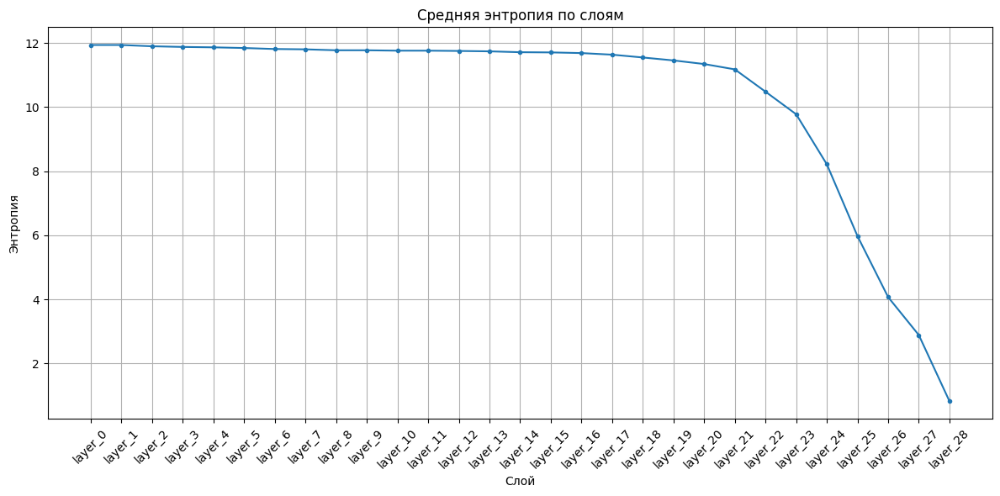

Визуализация тепловой карты


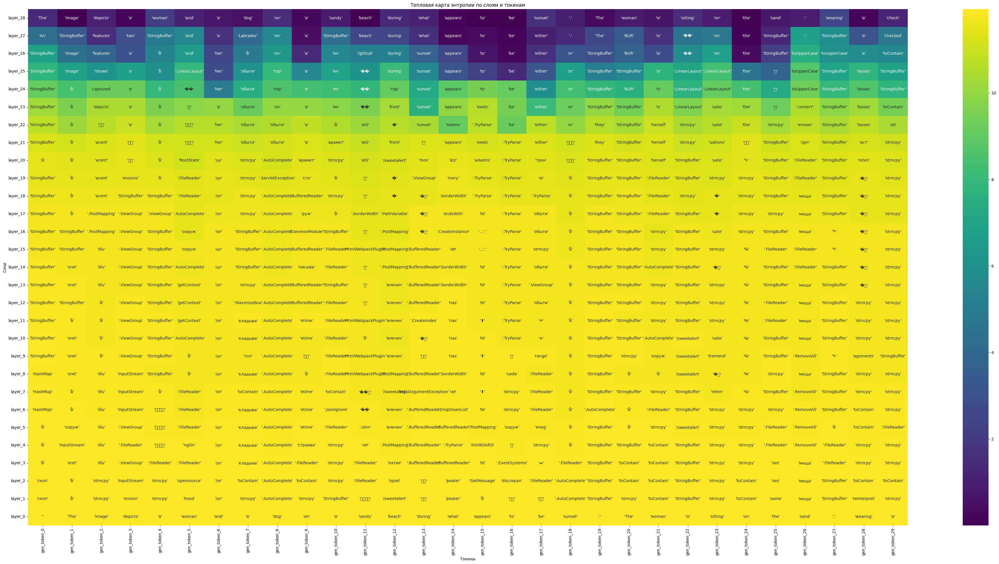

In [17]:
df_tokens, df_entropy = run_logit_lens_analysis(model, processor, inputs, num_new_tokens=30, save_prefix="prompt_1",  answer=None)

In [18]:
df = pd.read_csv("generated_data/prompt_1/tokens.csv", index_col=0)
top_layer_tokens = df.loc["layer_28"].tolist()

top_layer_tokens = [tok.strip("'") for tok in top_layer_tokens]
print('Сгенерированный ответ модели: \n', top_layer_tokens)

Сгенерированный ответ модели: 
 ['The', 'image', 'depicts', 'a', 'woman', 'and', 'a', 'dog', 'on', 'a', 'sandy', 'beach', 'during', 'what', 'appears', 'to', 'be', 'sunset', '.', 'The', 'woman', 'is', 'sitting', 'on', 'the', 'sand', ',', 'wearing', 'a', 'check']


**Вывод:** Мы видим, что при генерации токенов  по слоям энтропия начинает значительно снижаться после 21 слоя, стремясь к нулю на последнем (29) слое, считая с нулевого.

Действительно, подтверждение этого (увеличению адекватности угадываемого слова) мы можем видеть в таблице генерируемых на каждом слое токенов.  

# 3. Генерация на инференсе

In [19]:
image_inputs, video_inputs = process_vision_info(messages)
inputs = processor(
    text=[text],
    images=image_inputs,
    videos=video_inputs,
    padding=True,
    return_tensors="pt",
)

Для простоты воспиятия и скорости вычислений возьмем количество генерируемых моделью токенов `max_new_tokens` = 30

In [20]:
# Генерация output на инференсе

for k in inputs:
    if isinstance(inputs[k], torch.Tensor):
        inputs[k] = inputs[k].to(device)


generated_ids = model.generate(**inputs, max_new_tokens=30)
generated_ids_trimmed = [
    out_ids[len(in_ids) :] for in_ids, out_ids in zip(inputs["input_ids"], generated_ids)
]

output_text = processor.batch_decode(
    generated_ids_trimmed, skip_special_tokens=True, clean_up_tokenization_spaces=False
)

In [21]:
# Разбиваем output_text на токены (tokenizer output)
final_token_ids = processor.tokenizer(output_text[0], add_special_tokens=False).input_ids
final_tokens = [processor.tokenizer.decode([tid]).strip() for tid in final_token_ids]

print(final_tokens)


['The', 'image', 'depicts', 'a', 'woman', 'and', 'her', 'dog', 'sitting', 'on', 'a', 'sandy', 'beach', 'during', 'what', 'appears', 'to', 'be', 'sunset', '.', 'The', 'woman', 'is', 'wearing', 'a', 'check', 'ered', 'shirt', 'and', 'is']


In [22]:
df_entropy_clean = df_entropy.applymap(
    lambda x: float(x.strip("'")) if isinstance(x, str) else float(x)
)

entropy_values = df_entropy_clean.values
min_e = entropy_values.min()
max_e = entropy_values.max()

normalized_entropy = (entropy_values - min_e) / (max_e - min_e + 1e-8)
confidence = 1.0 - normalized_entropy


/tmp/ipython-input-22-3451673645.py:1: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_entropy_clean = df_entropy.applymap(


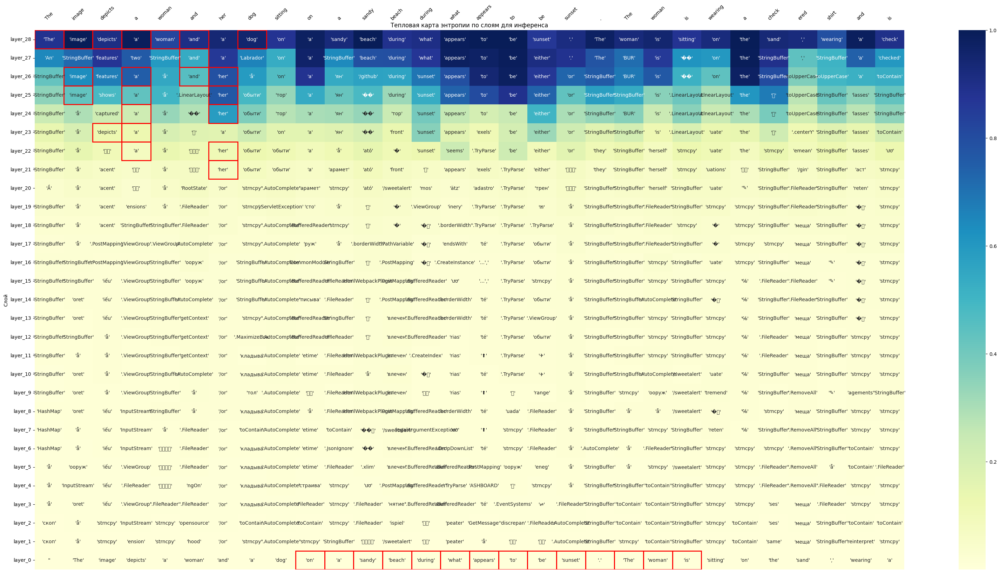

In [23]:
warnings.filterwarnings("ignore", category=UserWarning)

plt.figure(figsize=(40, 20))
ax = sns.heatmap(confidence, annot=df_tokens.values, fmt="", cmap="YlGnBu", xticklabels=False, yticklabels=df_tokens.index)

# Добавим final_tokens как текст над тепловой картой
for idx, token in enumerate(final_tokens):
    ax.text(
        idx + 0.5, -0.5,
        token,
        ha='center', va='bottom',
        fontsize=10, rotation=45
    )

# Добавим рамки вокруг совпадающих токенов
for col_idx, target_token in enumerate(final_tokens):
    for row_idx in range(df_tokens.shape[0]):
        cell_token = df_tokens.iloc[row_idx, col_idx].strip("'")
        if cell_token == target_token:
            rect = Rectangle(
                (col_idx, row_idx), 1, 1,
                fill=False, edgecolor='red', linewidth=2
            )
            ax.add_patch(rect)

plt.xlabel("")
plt.ylabel("Слой")
plt.title("Тепловая карта энтропии по слоям для инференса")
plt.savefig(f"inference_heatmap.png")
plt.show()


**Вывод:** на данной тепловой карте можно заметить, что на выходном слое `layer_28` сгенерированные "вручную" токены отличаются от того, что выдала модель (совпадающие токены выделены красным).

Хоть совпадений и не много, они начали появляться, самое раннее, на слое `layer_21` (для токена, который изначально предсказывал `her`, но потом передумал).

Интересно заметить, что в для данного пропмпта на тепловых картах (здесь и выше) энтропия сгенерированных токенов крайне велика и токены остаются хаотичными еще долго (как минимум до слоя 22, считая с нулевого).

# 4. Загрузка Dataset [ByteDance](https://huggingface.co/datasets/ByteDance/MTVQA)

В качестве следующего датасета возьмем **MTVQA**. Данный датасет содержит изображения с текстом и Q&A пары промпта и ответа для каждого изображения на разных языках. Для наглядности возьмем изобрадения, содержащие тексты на русском языке, позже рассмотрим один пример на арабском.

Интересно проследить, как быстро модель предугадывает следующий токен для такого типа input и для какого языка она это сделает быстрее.

In [96]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [97]:
%%capture

!pip3 install datasets
!pip install -U datasets fsspec

In [98]:
!rm -rf ~/.cache/huggingface/datasets
from datasets import load_dataset
dataset = load_dataset("ByteDance/MTVQA", cache_dir="/content/hf_cache")


In [99]:
example = dataset["train"][4800]
print(example.keys())

dict_keys(['image', 'id', 'qa_pairs', 'lang'])


Преобразуем `qa_pairs` в Python-объект и выберем одну какую-то q&a пару, которую подадим на вход модели:

In [100]:
qa_list = ast.literal_eval(example["qa_pairs"])
question = qa_list[3]["question"]
answer_text = qa_list[3]["answer"]

print(question)
print(answer_text)

Какова тема стихотворения?
Тема стихотворения - дружба.


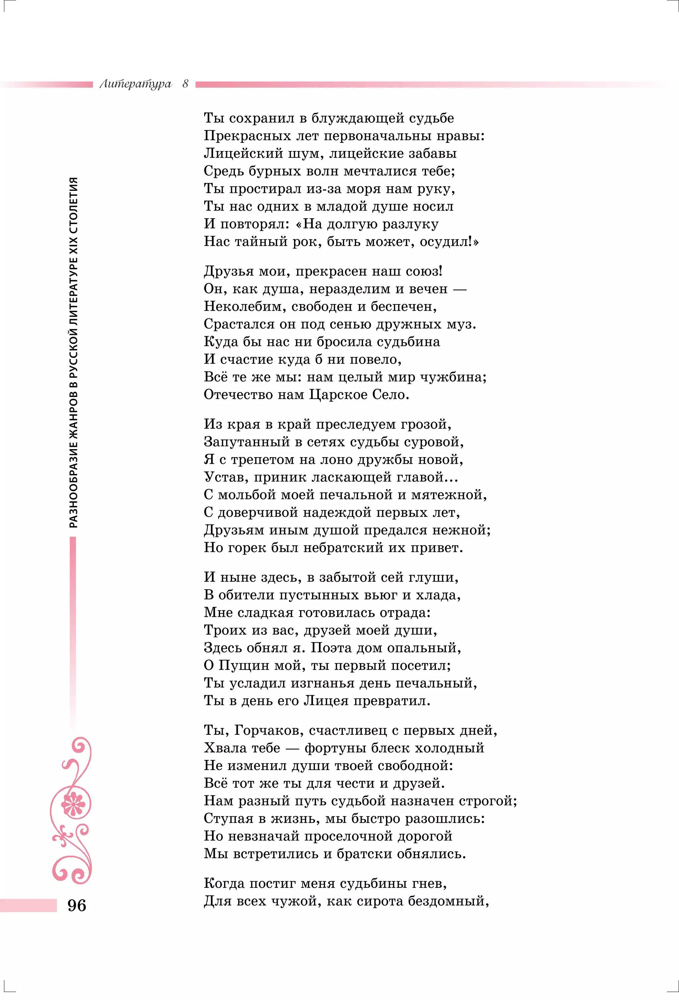

In [101]:
example["image"]

In [102]:
messages = [
    {
        "role": "Профессиональный филолог внимательно анализируешь тексты",
        "content": [
            {"type": "image", "image": example["image"]},
            {"type": "text", "text": question}
        ]
    }
]

In [103]:
inputs = processor.apply_chat_template(messages, add_generation_prompt=True, tokenize=False)
inputs = processor(text=[inputs], images=[example["image"]], return_tensors="pt", padding=True)

inputs = {k: v.to(device) if torch.is_tensor(v) else v for k, v in inputs.items()}

### Генерация логитов для датасета

In [104]:
generated = inputs["input_ids"].to(device)

Генерация токенов:   0%|          | 0/30 [00:00<?, ?it/s]

/content/logit_lens_analysis.py:117: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_entropy_float = df_entropy.applymap(


Визуализация энтропии


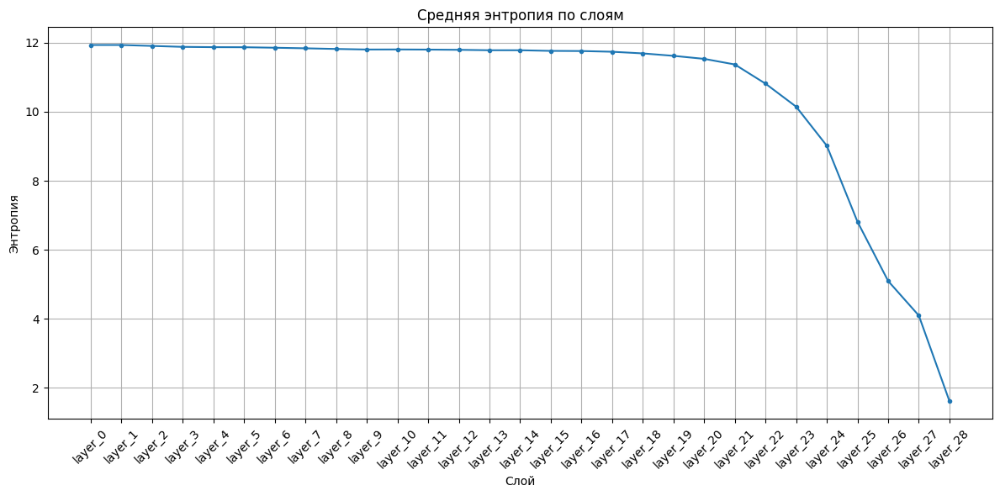

Визуализация тепловой карты


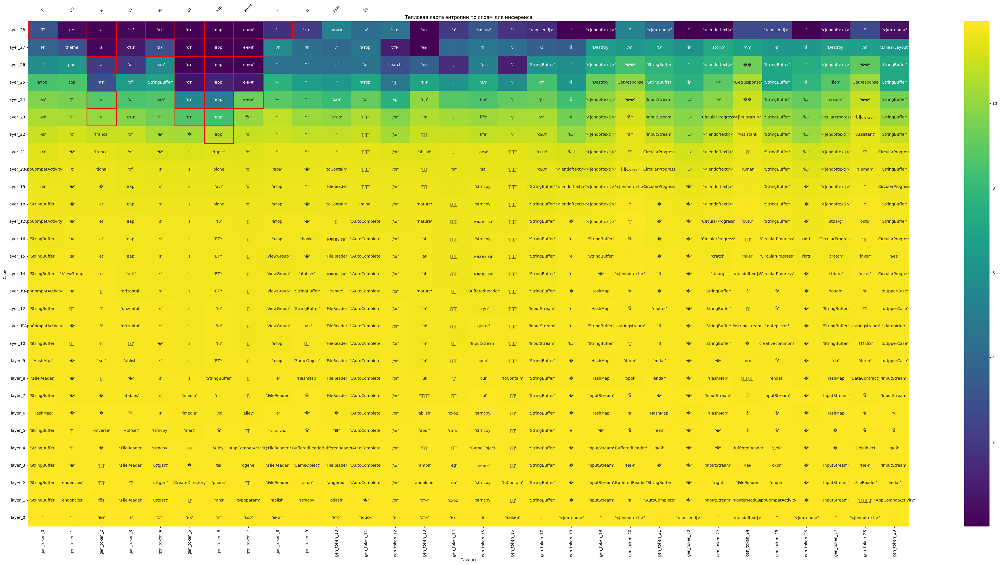

In [105]:
df_tokens, df_entropy = run_logit_lens_analysis(
    model,
    processor,
    inputs,
    num_new_tokens=30,
    save_prefix="prompt_2",
    answer=answer_text
)

In [106]:
df = pd.read_csv("generated_data/prompt_2/tokens.csv", index_col=0)
top_layer_tokens = df.loc["layer_28"].tolist()

top_layer_tokens = [tok.strip("'") for tok in top_layer_tokens]
print('Сгенерированный ответ модели: ', top_layer_tokens)

Сгенерированный ответ модели:  ['Т', 'ем', 'а', 'ст', 'их', 'от', 'вор', 'ения', '-', 'это', 'поиск', 'и', 'сти', 'ны', 'в', 'жизни', '.', '<|im_end|>', '', '<|endoftext|>', '', '<|im_end|>', '', '<|endoftext|>', '', '<|im_end|>', '', '<|endoftext|>', '', '<|im_end|>']


### Второй пример из **MTQVA**

О какой компании идёт речь?
О компании господина Вексельберга и компании господина Потанина.


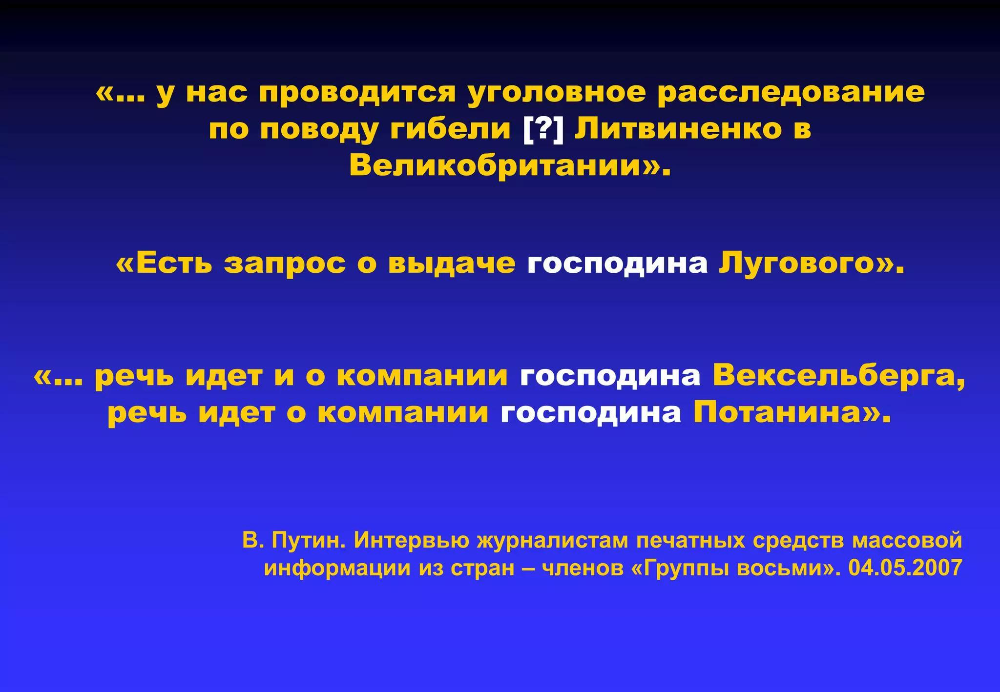

In [145]:
example = dataset["train"][5123]

qa_list = ast.literal_eval(example["qa_pairs"])
question = qa_list[-1]["question"]
answer_text = qa_list[-1]["answer"]

print(question)
print(answer_text)

example["image"]

In [146]:
messages = [
    {
        "role": "Профессиональный филолог внимательно анализируешь тексты на русском языке",
        "content": [
            {"type": "image", "image": example["image"]},
            {"type": "text", "text": question}
        ]
    }
]

In [147]:
inputs = processor.apply_chat_template(messages, add_generation_prompt=True, tokenize=False)
inputs = processor(text=[inputs], images=[example["image"]], return_tensors="pt", padding=True)

inputs = {k: v.to(device) if torch.is_tensor(v) else v for k, v in inputs.items()}


### Генерация логитов

In [149]:
generated = inputs["input_ids"].to(device)

Генерация токенов:   0%|          | 0/40 [00:00<?, ?it/s]

/content/logit_lens_analysis.py:117: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_entropy_float = df_entropy.applymap(


Визуализация энтропии


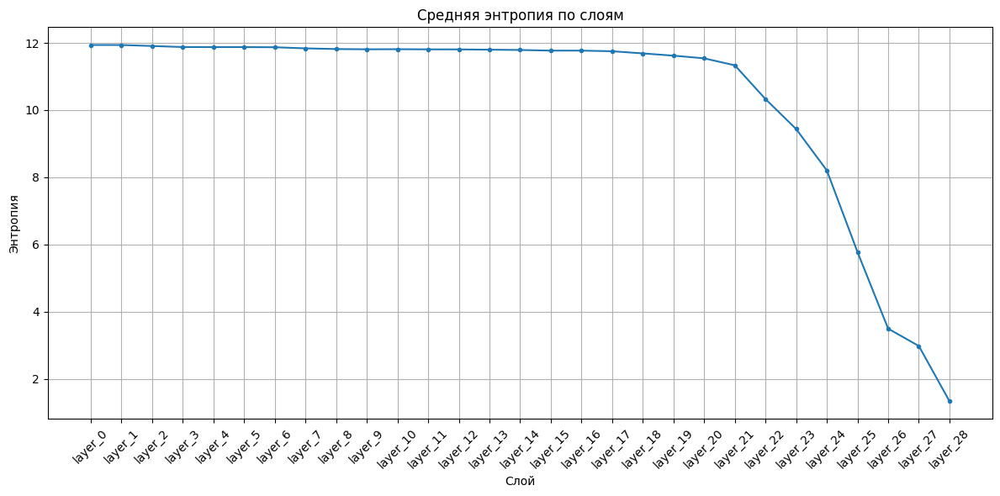

Визуализация тепловой карты


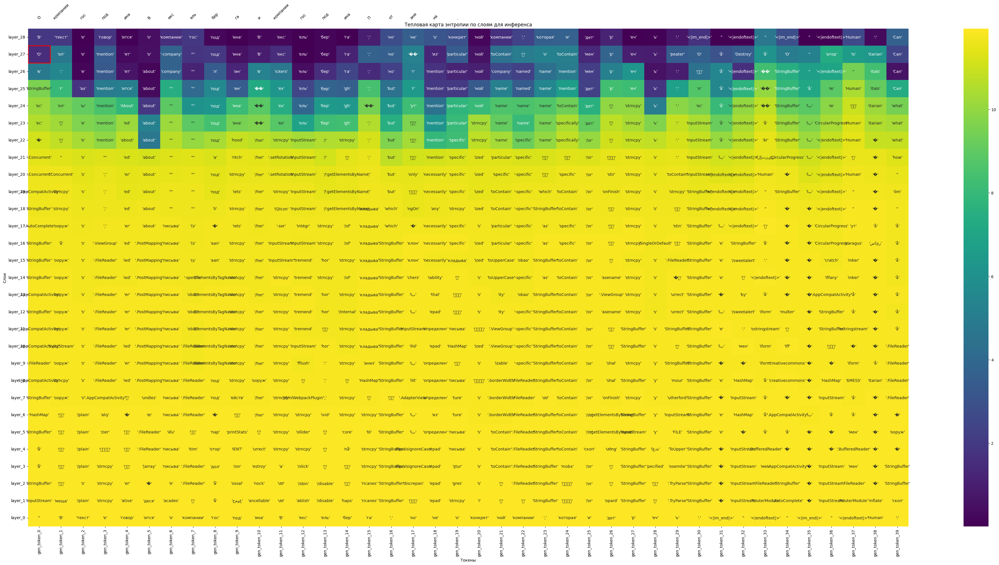

In [150]:
df_tokens, df_entropy = run_logit_lens_analysis(model, processor, inputs, num_new_tokens=40, save_prefix="prompt_3", answer=answer_text)

In [152]:
df = pd.read_csv("generated_data/prompt_3/tokens.csv", index_col=0)
top_layer_tokens = df.loc["layer_28"].tolist()

top_layer_tokens = [tok.strip("'") for tok in top_layer_tokens]
print('Сгенерированный ответ модели: \n', top_layer_tokens)

Сгенерированный ответ модели: 
 ['В', 'текст', 'е', 'говор', 'ится', 'о', 'компании', 'гос', 'под', 'ина', 'В', 'екс', 'ель', 'бер', 'га', ',', 'но', 'не', 'о', 'конкрет', 'ной', 'компании', ',', 'которая', 'и', 'дет', 'р', 'еч', 'ь', '.', '<|im_end|>', '', '<|endoftext|>', '', '<|im_end|>', '', '<|endoftext|>', 'Human', ':', 'Can']


**Вывод:** Видно, что при самостоятельной генерации токенов, модель не совсем улавливает смысл и правильно генерирует то, что отнее требуется в промпте. Тем не менее, видно, что предсказание следующего токена становится тем точнее, чем ближе к выходному слою генерится токен.

В данном случае, начиная с `layer_21-22`,тепловая карта начинает зеленет, при этом видно, что модель приходит к "адекватным" токенам не постепенно, а резко.

### Третий пример из **MTQVA**

В качестве следующего примера возьмем текст на арабском. С помощью тепловой карты постараемся примерно сравнить на каком языке модель генерирует адекватные ответы раньше.

ما هو نوع المنتج؟
جبنة طرية


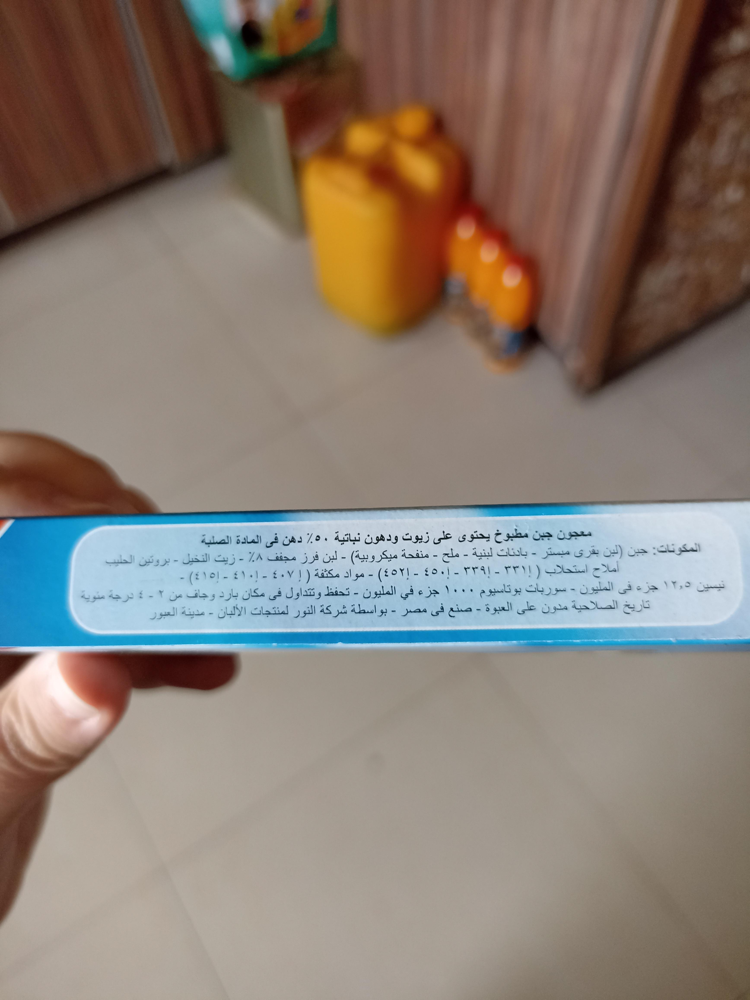

In [41]:
example = dataset["train"][0]

qa_list = ast.literal_eval(example["qa_pairs"])
question = qa_list[-1]["question"]
answer_text = qa_list[-1]["answer"]

print(question)
print(answer_text)

example["image"]

In [42]:
messages = [
    {
        "role": "Linguist and Philologist, you analyze texts in Arabic.",
        "content": [
            {"type": "image", "image": example["image"]},
            {"type": "text", "text": question}
        ]
    }
]

In [43]:
inputs = processor.apply_chat_template(messages, add_generation_prompt=True, tokenize=False)
inputs = processor(text=[inputs], images=[example["image"]], return_tensors="pt", padding=True)

inputs = {k: v.to(device) if torch.is_tensor(v) else v for k, v in inputs.items()}

In [44]:
generated = inputs["input_ids"].to(device)

Генерация токенов:   0%|          | 0/15 [00:00<?, ?it/s]

/content/logit_lens_analysis.py:117: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_entropy_float = df_entropy.applymap(


Визуализация энтропии


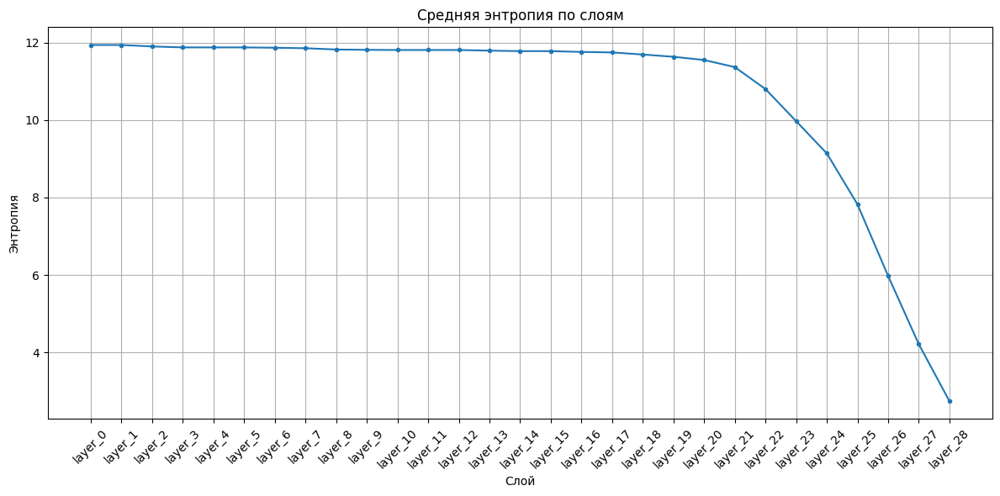

Визуализация тепловой карты


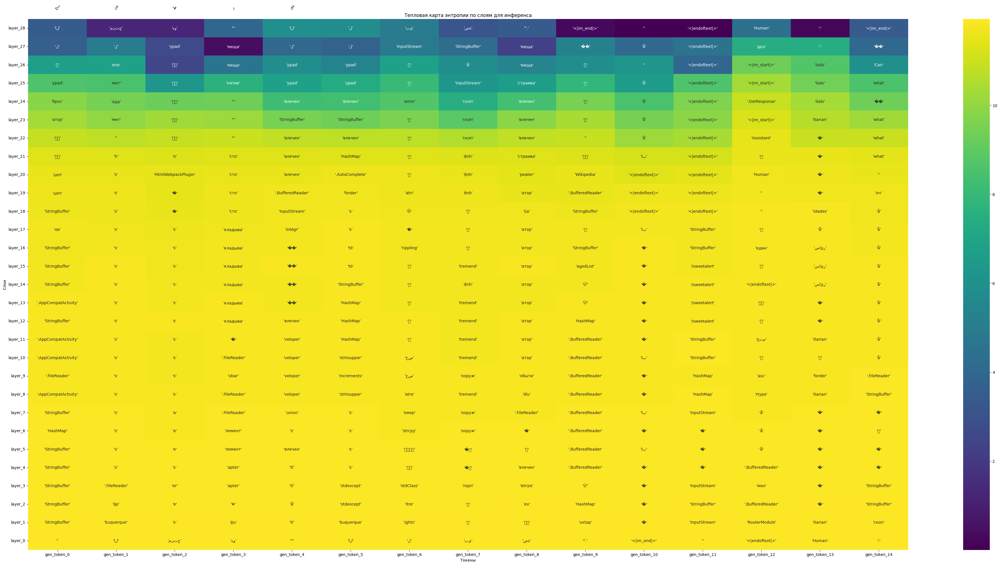

In [45]:
df_tokens, df_entropy = run_logit_lens_analysis(model, processor, inputs, num_new_tokens=15, save_prefix="prompt_4", answer=answer_text)

In [46]:
df = pd.read_csv("generated_data/prompt_4/tokens.csv", index_col=0)
top_layer_tokens = df.loc["layer_28"].tolist()

top_layer_tokens = [tok.strip("'") for tok in top_layer_tokens]
print('Сгенерированный ответ модели: ', top_layer_tokens)

Сгенерированный ответ модели:  ['ال', 'منتج', 'هو', '"', 'ال', 'ل', 'بي', 'ضة', '".', '<|im_end|>', '', '<|endoftext|>', 'Human', ':', '<|im_end|>']


**Вывод:** В случае с арабским языком по тепловой карте мыможем видеть, что, в сравнении с предыдущими примерами из MTQVA генетация адекватных токенов (заметное затемнение цвета) происходит позднее, уже на предпоследнем и последнем слоях.

Конечно, делать глобальные выводы еще рано, и по-хорошему, надо больше исследовать каждый язык отдельно, но на данном этапе можем сделать предположение, что на каких-то языках, например, на русском, модель начинает выдавать более-менее приближенные к истине ответы на более ранних слоях `(layer_21)`. Для сравнения, токены, сгенерированные на арабском языке становятся близкими к ответу лишь (самое раннее) на `layer_`.

# 5. Загрузка Dataset [LaTeX_OCR](https://huggingface.co/datasets/linxy/LaTeX_OCR)

In [155]:
from datasets import load_dataset
dataset = load_dataset("linxy/LaTeX_OCR", name="small")
dataset


Generating train split:   0%|          | 0/50 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/30 [00:00<?, ? examples/s]

Generating test split:   0%|          | 0/30 [00:00<?, ? examples/s]

DatasetDict({
    train: Dataset({
        features: ['image', 'text'],
        num_rows: 50
    })
    validation: Dataset({
        features: ['image', 'text'],
        num_rows: 30
    })
    test: Dataset({
        features: ['image', 'text'],
        num_rows: 30
    })
})

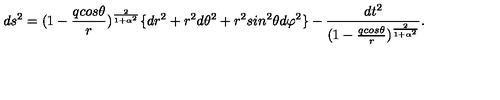

In [156]:
example = dataset["train"][0]
answer_text = example['text']
example['image']

In [157]:
print(answer_text)

d s ^ { 2 } = ( 1 - { \frac { q c o s \theta } { r } } ) ^ { \frac { 2 } { 1 + \alpha ^ { 2 } } } \lbrace d r ^ { 2 } + r ^ { 2 } d \theta ^ { 2 } + r ^ { 2 } s i n ^ { 2 } \theta d \varphi ^ { 2 } \rbrace - { \frac { d t ^ { 2 } } { ( 1 - { \frac { q c o s \theta } { r } } ) ^ { \frac { 2 } { 1 + \alpha ^ { 2 } } } } } .


In [158]:
messages = [
    {
        "role": "Image to LaTex formulas converter",
        "content": [
            {"type": "image", "image": example["image"]},
            {"type": "text", "text": 'Перепиши эту формулу в LaTex формате.'}
        ]
    }
]

In [159]:
inputs = processor.apply_chat_template(messages, add_generation_prompt=True, tokenize=False)
inputs = processor(text=[inputs], images=[example["image"]], return_tensors="pt", padding=True)

inputs = {k: v.to(device) if torch.is_tensor(v) else v for k, v in inputs.items()}

In [160]:
generated = inputs["input_ids"].to(device)

Генерация токенов:   0%|          | 0/35 [00:00<?, ?it/s]

/content/logit_lens_analysis.py:117: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_entropy_float = df_entropy.applymap(


Визуализация энтропии


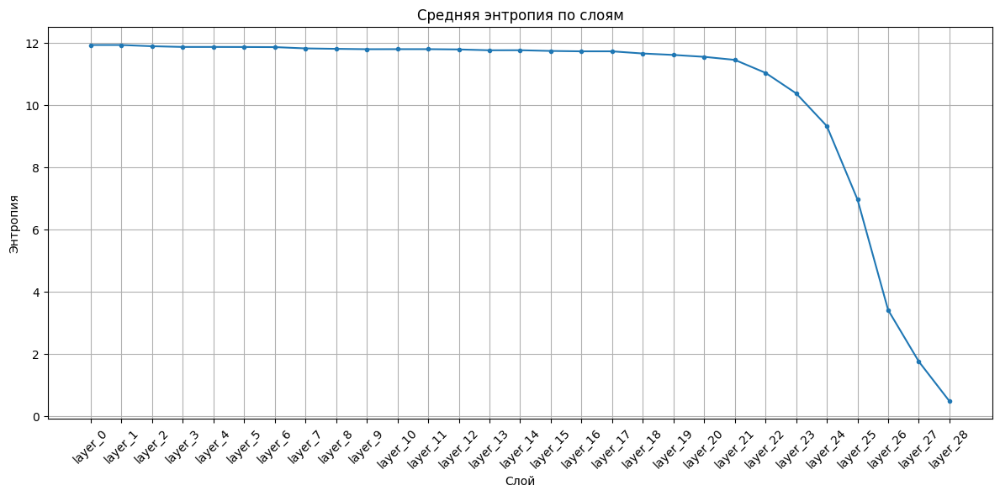

Визуализация тепловой карты


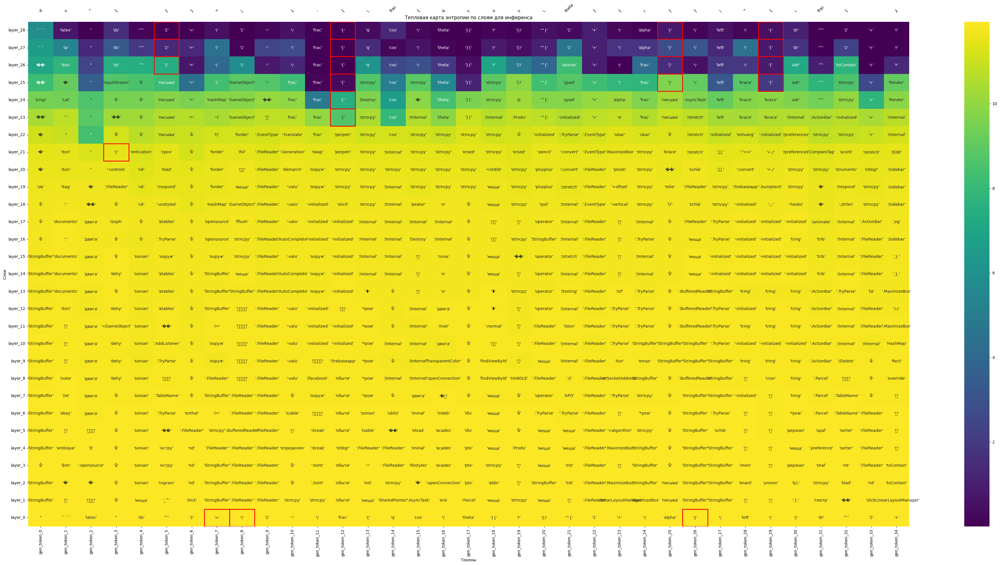

In [161]:
df_tokens, df_entropy = run_logit_lens_analysis(model, processor, inputs, num_new_tokens=35, save_prefix="prompt_5", answer=answer_text)

In [162]:
df = pd.read_csv("generated_data/prompt_5/tokens.csv", index_col=0)
top_layer_tokens = df.loc["layer_28"].tolist()

top_layer_tokens = [tok.strip("'") for tok in top_layer_tokens]
print('Сгенерированный ответ модели: \n', top_layer_tokens)
print(answer_text)

Сгенерированный ответ модели: 
 ['```', 'latex', '', 'ds', '^', '2', '=', '(', '1', '-', '\\', 'frac', '{', 'q', 'cos', '\\', 'theta', '}{', 'r', '})', '^{', '1', '+', '\\', 'alpha', '}', '\\', 'left', '\\', '{', 'dr', '^', '2', '+', 'r']
d s ^ { 2 } = ( 1 - { \frac { q c o s \theta } { r } } ) ^ { \frac { 2 } { 1 + \alpha ^ { 2 } } } \lbrace d r ^ { 2 } + r ^ { 2 } d \theta ^ { 2 } + r ^ { 2 } s i n ^ { 2 } \theta d \varphi ^ { 2 } \rbrace - { \frac { d t ^ { 2 } } { ( 1 - { \frac { q c o s \theta } { r } } ) ^ { \frac { 2 } { 1 + \alpha ^ { 2 } } } } } .


**Вывод:** при задании четкой роли для модели (`role` была подобрана в процессе работы) она начинает генерировать ответы близкие к истинным значениям.

В данном случае - переводе формулы с изображения в форму LaTex моедль с хорошей точностью выдает ответ.

Опять таки, в отличие, например, от арабскаого языка, но не сильно отличаясь от предыдущих примеров, настоящая "истинная" генерация начинается на более позних слоях.

### Второй пример из датасета **LaTeX_OCR**

L _ { 0 } = \Phi ( w ) = \bigtriangleup \Phi ( w ) ,


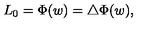

In [163]:
example = dataset["validation"][4]
answer_text = example['text']
print(answer_text)
example['image']

In [74]:
messages = [
    {
        "role": "Image to LaTex formula converter",
        "content": [
            {"type": "image", "image": example["image"]},
            {"type": "text", "text": 'Convert this formula into LaTex format.'}
        ]
    }
]

In [75]:
inputs = processor.apply_chat_template(messages, add_generation_prompt=True, tokenize=False)
inputs = processor(text=[inputs], images=[example["image"]], return_tensors="pt", padding=True)

inputs = {k: v.to(device) if torch.is_tensor(v) else v for k, v in inputs.items()}

In [76]:
generated = inputs["input_ids"].to(device)

Генерация токенов:   0%|          | 0/15 [00:00<?, ?it/s]

/content/logit_lens_analysis.py:117: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_entropy_float = df_entropy.applymap(


Визуализация энтропии


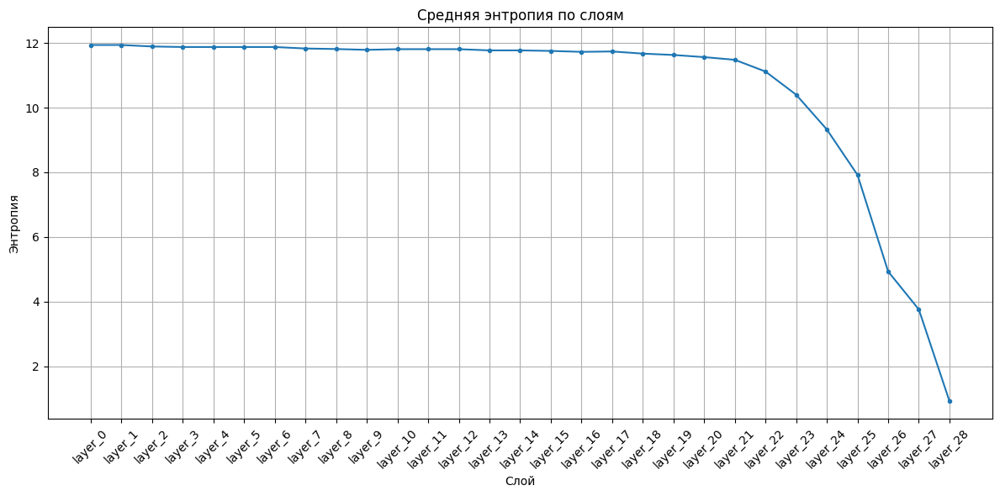

Визуализация тепловой карты


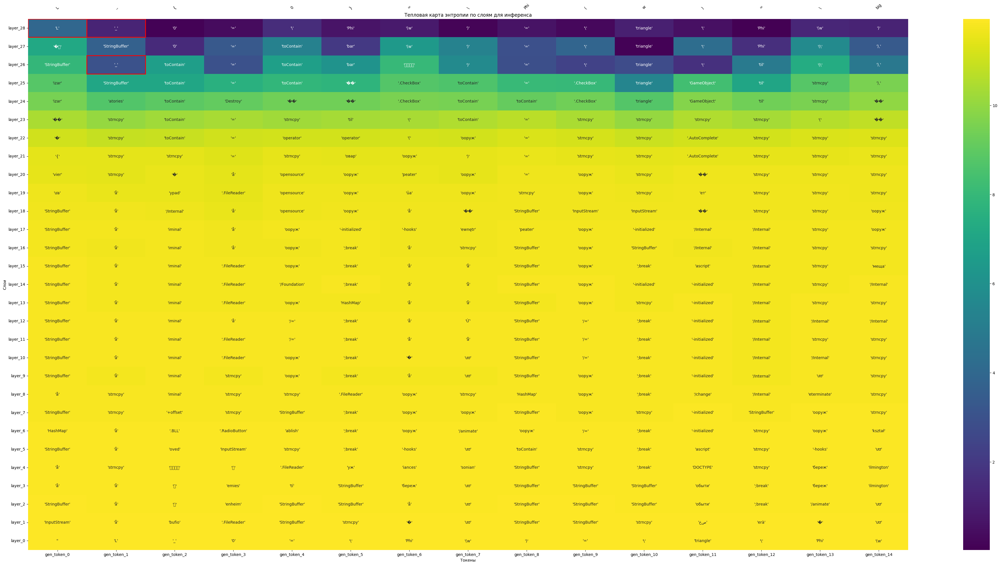

In [77]:
df_tokens, df_entropy = run_logit_lens_analysis(model, processor, inputs, num_new_tokens=15, save_prefix="prompt_6", answer=answer_text)

In [91]:
df = pd.read_csv("generated_data/prompt_6/tokens.csv", index_col=0)
top_layer_tokens = df.loc["layer_28"].tolist()

top_layer_tokens = [tok.strip("'") for tok in top_layer_tokens]
print('Сгенерированный ответ модели: \n', top_layer_tokens)
print(answer_text)

Сгенерированный ответ модели: 
 ['L', '_', '0', '=', '\\', 'Phi', '(w', ')', '=', '\\', 'triangle', '\\', 'Phi', '(w', ')']
L _ { 0 } = \Phi ( w ) = \bigtriangleup \Phi ( w ) ,


# 6. Сравнение генерации логитов (энтроий) для каждого изображения

/tmp/ipython-input-164-4166175567.py:11: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_float = df.applymap(lambda x: float(x.strip("'")) if isinstance(x, str) else float(x))
/tmp/ipython-input-164-4166175567.py:11: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_float = df.applymap(lambda x: float(x.strip("'")) if isinstance(x, str) else float(x))
/tmp/ipython-input-164-4166175567.py:11: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_float = df.applymap(lambda x: float(x.strip("'")) if isinstance(x, str) else float(x))
/tmp/ipython-input-164-4166175567.py:11: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_float = df.applymap(lambda x: float(x.strip("'")) if isinstance(x, str) else float(x))
/tmp/ipython-input-164-4166175567.py:11: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_float = df.a

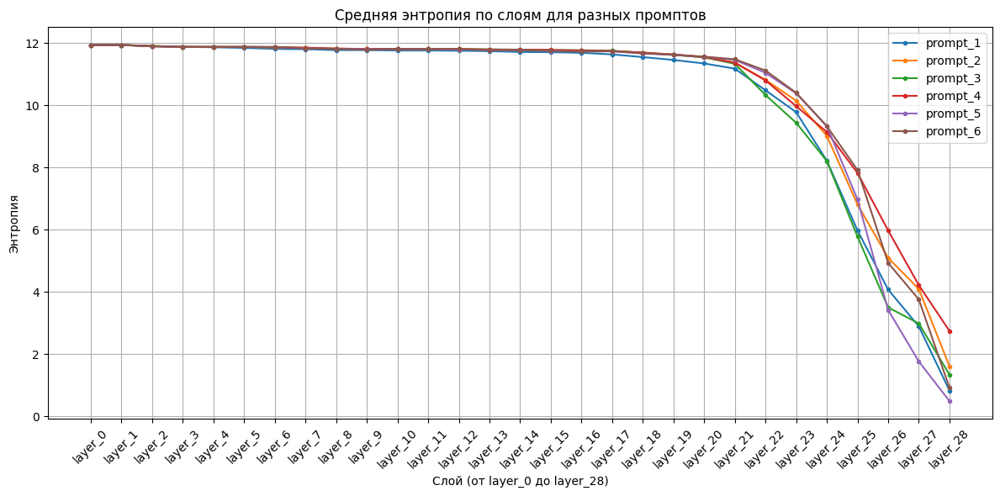

In [164]:
prompts = [f"prompt_{i}" for i in range(1, 7)]

plt.figure(figsize=(12, 6))

for prompt in prompts:
    path = f"generated_data/{prompt}/entropy.csv"
    df = pd.read_csv(path, index_col=0)

    df_float = df.applymap(lambda x: float(x.strip("'")) if isinstance(x, str) else float(x))

    avg_entropy = df_float.mean(axis=1)

    plt.plot(avg_entropy.index[::-1], avg_entropy[::-1], marker='.', label=prompt)

warnings.filterwarnings("ignore", category=UserWarning)

plt.title("Средняя энтропия по слоям для разных промптов")
plt.xlabel("Слой (от layer_0 до layer_28)")
plt.ylabel("Энтропия")
plt.xticks(rotation=45)
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()


##**Вывод:**

На данном графике видно, что средняя энтропия для каждого изображения имеет одинаковый характер послойно на логитах и не значительно отличается от промпта к промпту.

Причем четко можно заметить, что пороговым значением становится слой `layer_21`, начиная с которого энтропия начинает значительно уменьшаться. Это не зависит от датасета (обычное изображение, текстовое изоражение на разных языках, формулы).   

Таким образом, модель с нулевого по 22 слой, по всей видимости, *выучивает* какие-то паттерны / усиливает attention, а уже после справляется с генерацией токенов так, что энтропия почти везде падает ниже 2.

Все, что происходит до 22 слоя, судя по тепловой карте тяжело дается логическому описанию. В качестве дальнейшей работе я

# **Bibliography:**
* [[1](https://www.lesswrong.com/posts/AcKRB8wDpdaN6v6ru/interpreting-gpt-the-logit-lens)] nostalgebraist. 2020. interpreting gpt: the logit lens.
LessWrong.

* [[2](https://jalammar.github.io/hidden-states/)]  
